In [ ]:
!pip install roboflow ultralytics


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 874.1/874.1 kB 17.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 2.9 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


In [ ]:
!pip install roboflow opencv-python-headless albumentations

import os
import cv2
import random
import numpy as np
from roboflow import Roboflow
import matplotlib.pyplot as plt
import albumentations as A
from google.colab.patches import cv2_imshow


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 80.3/80.3 kB 5.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 6.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 4.9 MB/s eta 0:00:00
  Attempting uninstall: idna
    Found existing installation: idna 3.10
    Uninstalling idna-3.10:
      Successfully uninstalled idna-3.10


A new version of Albumentations is available: 1.4.16 (you have 1.4.15). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.


# New Dataset

In [ ]:
!pip install roboflow

loading Roboflow workspace...
loading Roboflow project...
Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.
Dependency ultralytics==8.0.196 is required but found version=8.2.101, to fix: `pip install ultralytics==8.0.196`



Extracting Dataset Version Zip to Emeregncy-detection-1 in yolov8:: 100%|██████████| 526/526 [00:01<00:00, 487.55it/s]


In [ ]:
!pip install ultralytics==8.0.196

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 631.1/631.1 kB 7.1 MB/s eta 0:00:00


In [ ]:
rf = Roboflow(api_key="t7joBcGDO1klwwIwVwOP")
project = rf.workspace("rakans-workspace").project("emeregncy-detection")
version = project.version(1)
dataset = version.download("yolov8")

loading Roboflow workspace...
loading Roboflow project...


In [ ]:
import glob

image_paths = glob.glob(os.path.join(dataset.location, 'train/images', '*.jpg'))
label_paths = glob.glob(os.path.join(dataset.location, 'train/labels', '*.txt'))

print(f'Number of images: {len(image_paths)}')
print(f'Number of labels: {len(label_paths)}')


Number of images: 225
Number of labels: 225


In [ ]:
for img_path, lbl_path in zip(image_paths, label_paths):
    print(f'Image: {img_path}, Label: {lbl_path}')


Image: /content/Emeregncy-detection-1/train/images/Screenshot-2024-09-25-at-5-54-01-PM_png.rf.368035b3c69ff45fb213d4d1a1e4d4a4.jpg, Label: /content/Emeregncy-detection-1/train/labels/Screenshot-2024-09-25-at-5-55-35-PM_png.rf.6297bde64648b5c1b9e09a7674f75e51.txt
Image: /content/Emeregncy-detection-1/train/images/Screenshot-2024-09-26-at-8-54-21-AM_png.rf.7e99f0c08aa5272b5af6ae5533f827af.jpg, Label: /content/Emeregncy-detection-1/train/labels/Screenshot-2024-09-26-at-8-51-54-AM_png.rf.0a43051197c114f298e9e3c647b35b60.txt
Image: /content/Emeregncy-detection-1/train/images/Screenshot-2024-09-26-at-8-53-08-AM_png.rf.9353039de6e32e89246ef6348147f512.jpg, Label: /content/Emeregncy-detection-1/train/labels/Screenshot-2024-09-25-at-5-57-19-PM_png.rf.a467ea143cfeefa44de253d9eb26ed4b.txt
Image: /content/Emeregncy-detection-1/train/images/Screenshot-2024-09-25-at-5-55-11-PM_png.rf.a67d434b2a32ea733edf74a42d424cc4.jpg, Label: /content/Emeregncy-detection-1/train/labels/Screenshot-2024-09-26-at-8-5

In [ ]:
import os
import shutil

# Paths to images and labels
image_dir = "/content/Emeregncy-detection-1/train/images/"
label_dir = "/content/Emeregncy-detection-1/train/labels/"

# Get image and label filenames
image_files = sorted(os.listdir(image_dir))
label_files = sorted(os.listdir(label_dir))

# Check if their base filenames match
for image_file, label_file in zip(image_files, label_files):
    image_base = os.path.splitext(image_file)[0]
    label_base = os.path.splitext(label_file)[0]

    if image_base != label_base:
        print(f"Mismatch found: {image_file} -> {label_file}")
        # Optionally, rename the label to match the image
        new_label_path = os.path.join(label_dir, f"{image_base}.txt")
        shutil.move(os.path.join(label_dir, label_file), new_label_path)
        print(f"Renamed {label_file} to {image_base}.txt")
    else:
        print(f"Match: {image_file} -> {label_file}")


Match: Screenshot-2024-09-25-at-5-54-01-PM_png.rf.368035b3c69ff45fb213d4d1a1e4d4a4.jpg -> Screenshot-2024-09-25-at-5-54-01-PM_png.rf.368035b3c69ff45fb213d4d1a1e4d4a4.txt
Match: Screenshot-2024-09-25-at-5-54-01-PM_png.rf.89899764ac7b37d8de7b586b364c803a.jpg -> Screenshot-2024-09-25-at-5-54-01-PM_png.rf.89899764ac7b37d8de7b586b364c803a.txt
Match: Screenshot-2024-09-25-at-5-54-01-PM_png.rf.a6b997e8a1e92d0b5e06d6c6e77b2488.jpg -> Screenshot-2024-09-25-at-5-54-01-PM_png.rf.a6b997e8a1e92d0b5e06d6c6e77b2488.txt
Match: Screenshot-2024-09-25-at-5-54-07-PM_png.rf.d57a8f3eaf8fb83841de709314007208.jpg -> Screenshot-2024-09-25-at-5-54-07-PM_png.rf.d57a8f3eaf8fb83841de709314007208.txt
Match: Screenshot-2024-09-25-at-5-54-07-PM_png.rf.da46930afa588fbd043592cf4c8d326c.jpg -> Screenshot-2024-09-25-at-5-54-07-PM_png.rf.da46930afa588fbd043592cf4c8d326c.txt
Match: Screenshot-2024-09-25-at-5-54-07-PM_png.rf.dfc536840196e5d87be0a89c12edf158.jpg -> Screenshot-2024-09-25-at-5-54-07-PM_png.rf.dfc536840196e5d87

In [ ]:
!ls /content/Emeregncy-detection-1

data.yaml  README.dataset.txt  README.roboflow.txt  test  train  valid


In [ ]:
import os
import shutil

# Define the path to your source folder (which contains train, test, valid folders) and the new sorted folder
source_folder = '/content/Emeregncy-detection-1'
sorted_folder = '/content/sorted_emergency'  # Path to the new sorted_emergency folder (outside the original folder)

# List of subdirectories (e.g., train, test, valid)
subdirs = ['train', 'test', 'valid']
# Corresponding subfolders for images and labels
subfolders = ['images', 'labels']

# Function to sort and move image and label files in subdirectories
def sort_and_move_files(subdir):
    # Create subdirectory for images and labels in the sorted folder
    for subfolder in subfolders:
        source_subdir = os.path.join(source_folder, subdir, subfolder)
        sorted_subdir = os.path.join(sorted_folder, subdir, subfolder)

        # Create the images/labels subdirectories if they don't exist in sorted folder
        if not os.path.exists(sorted_subdir):
            os.makedirs(sorted_subdir)

        # List all files in the source subdir and sort them alphabetically
        files = sorted(os.listdir(source_subdir))

        # Move each file (image or label) to the corresponding subdirectory in the sorted folder
        for file_name in files:
            # Construct full file path for source and destination
            source_file = os.path.join(source_subdir, file_name)
            sorted_file = os.path.join(sorted_subdir, file_name)

            # Check if it's a file (not a directory)
            if os.path.isfile(source_file):
                # Copy the file to the sorted subdirectory
                shutil.copy2(source_file, sorted_file)

# Loop through each 'train', 'test', 'valid' subdirectory and sort its files
for subdir in subdirs:
    sort_and_move_files(subdir)

print(f"Files have been sorted and copied to {sorted_folder}.")


Files have been sorted and copied to /content/sorted_emergency.


In [ ]:
!ls /content/sorted_emergency/train/ima

images	labels


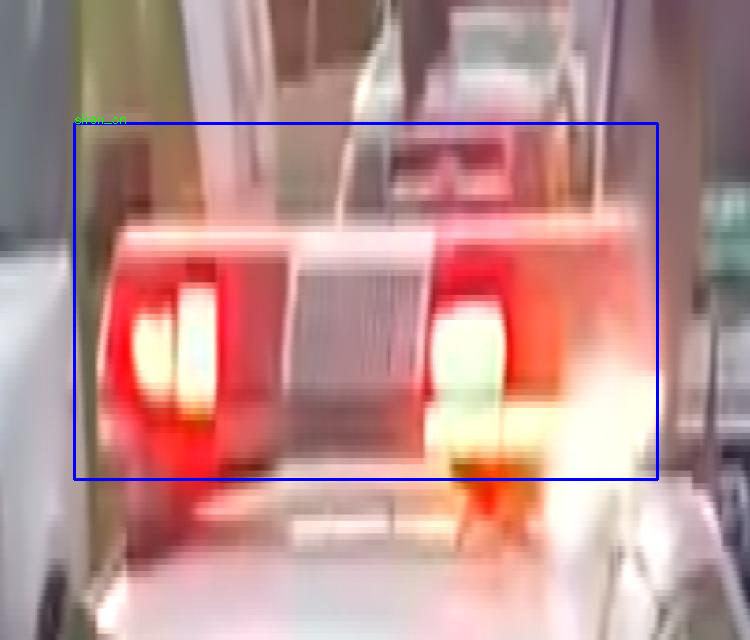

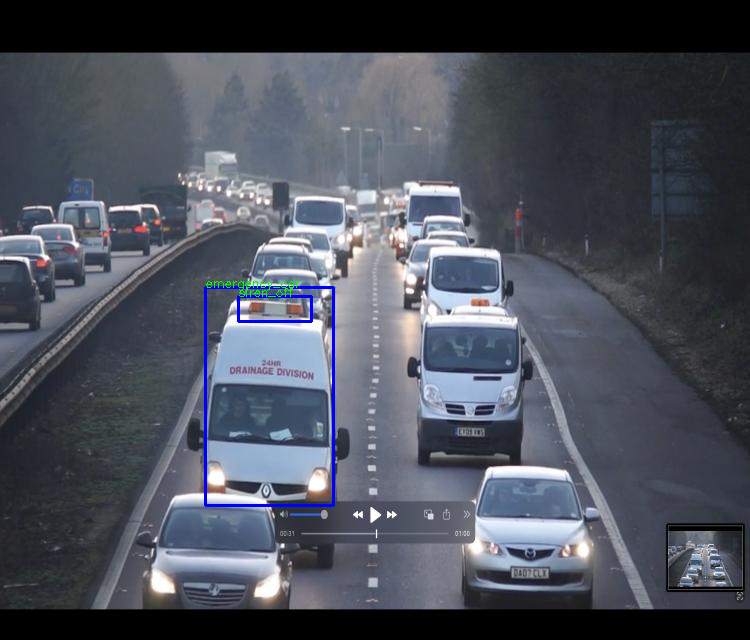

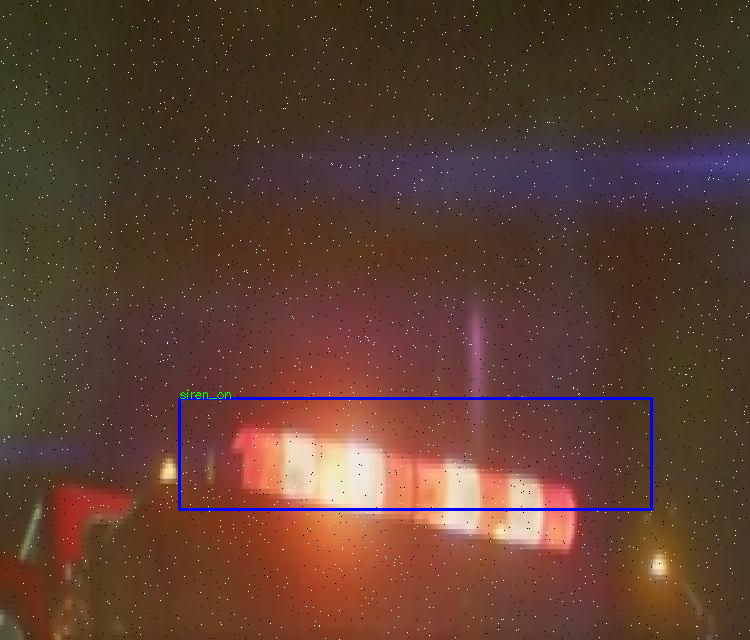

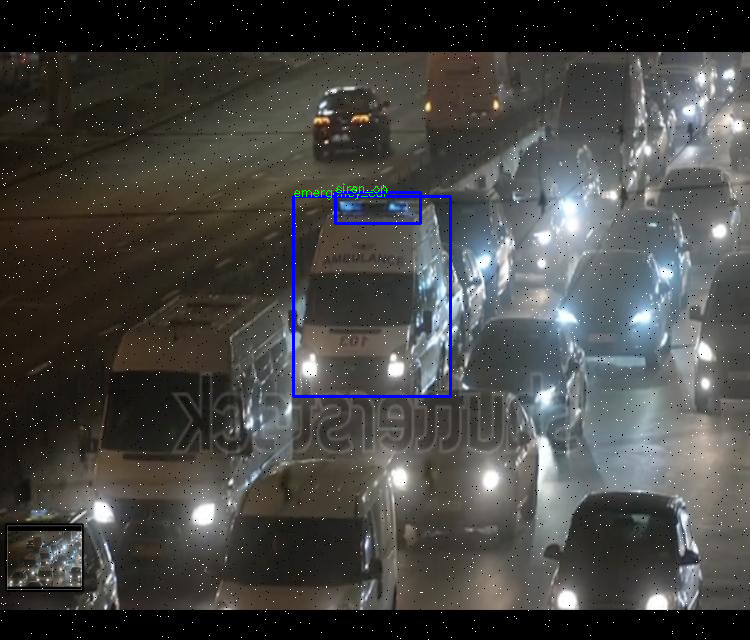

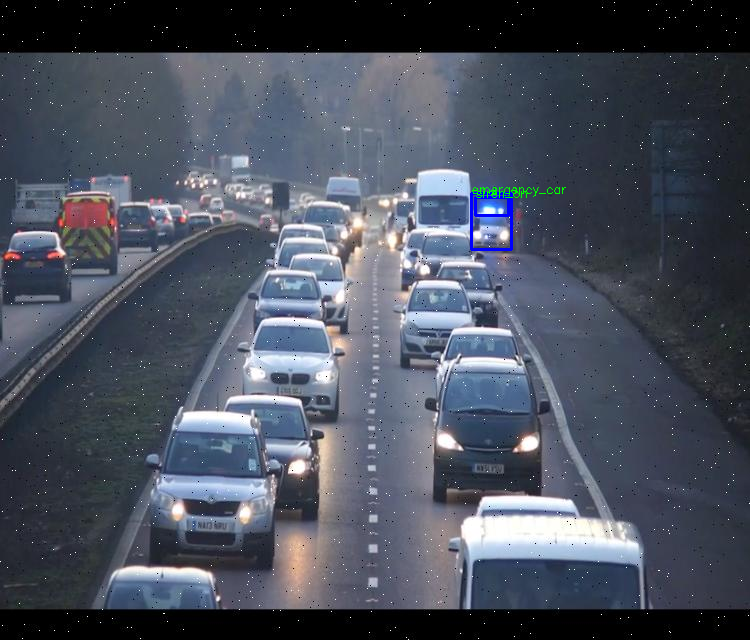

...

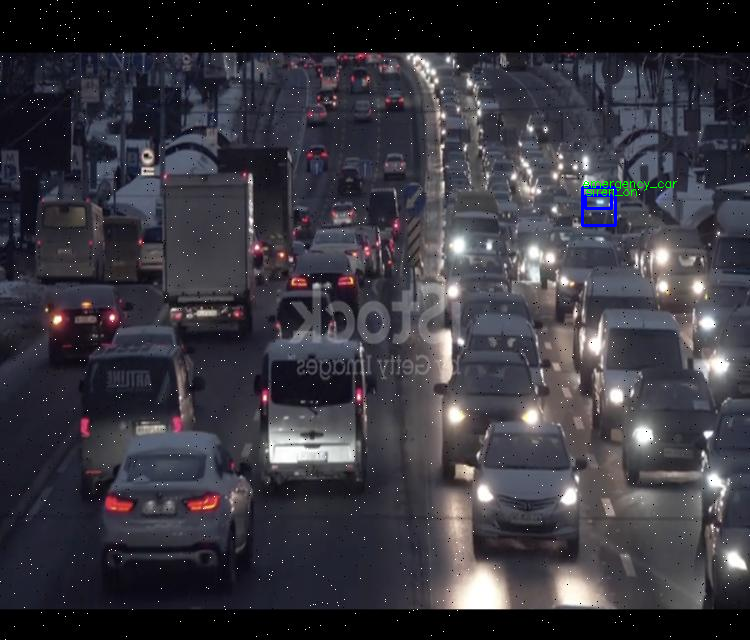

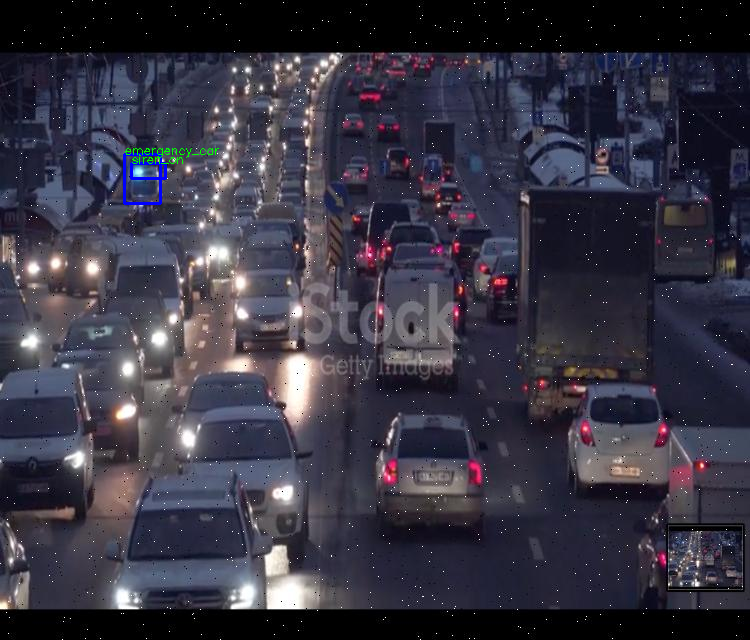

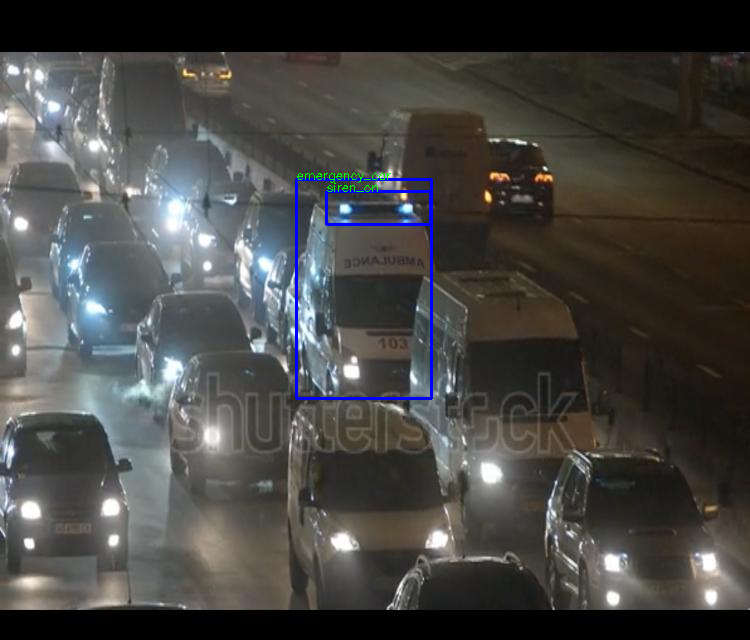

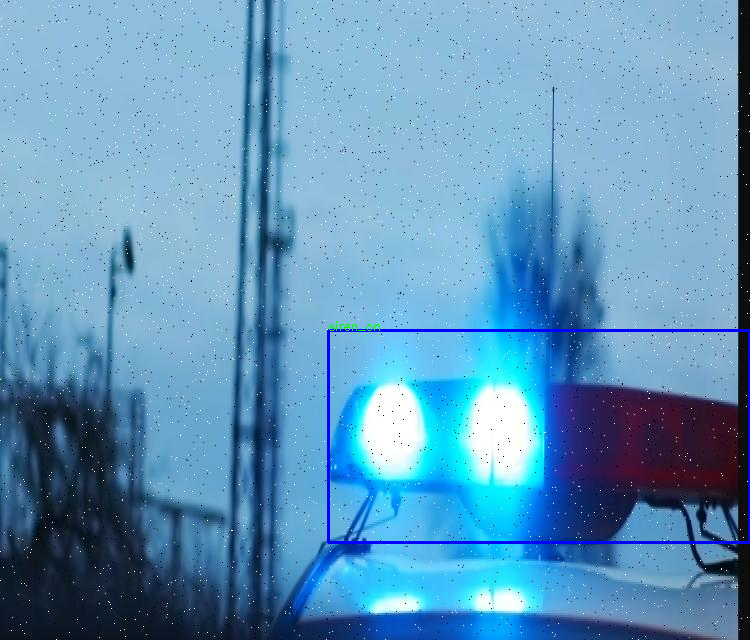

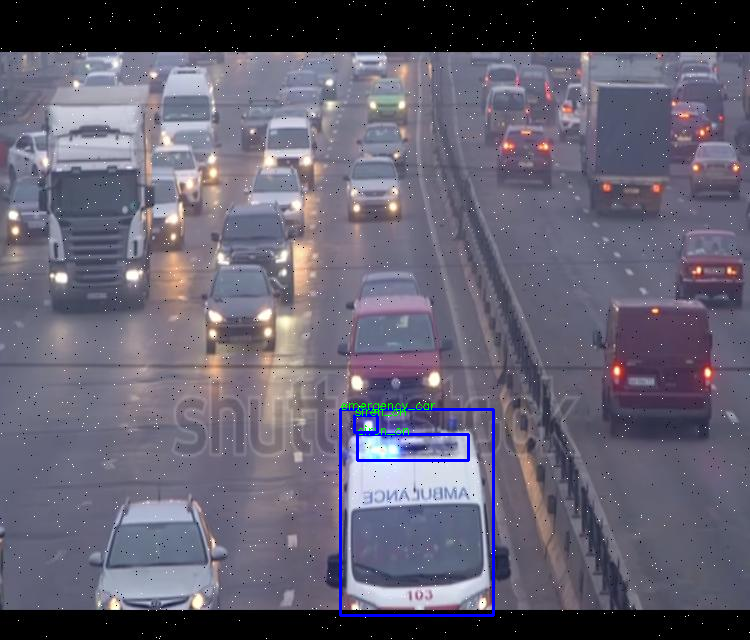

In [ ]:
import cv2
import numpy as np
import os
import random
from google.colab.patches import cv2_imshow  # For Google Colab, replace with cv2.imshow for local

# Function to read YOLO labels
def read_yolo_labels(label_file):
    with open(label_file, 'r') as f:
        lines = f.readlines()
    bboxes = []
    class_labels = []
    for line in lines:
        class_id, x, y, w, h = map(float, line.strip().split())
        bboxes.append([x, y, w, h])
        class_labels.append(int(class_id))
    return bboxes, class_labels

# Function to plot images with bounding boxes
def plot_image_with_bboxes(image, bboxes, class_labels, class_names):
    for bbox, label in zip(bboxes, class_labels):
        x, y, w, h = bbox
        start_point = (int((x - w / 2) * image.shape[1]), int((y - h / 2) * image.shape[0]))
        end_point = (int((x + w / 2) * image.shape[1]), int((y + h / 2) * image.shape[0]))
        image = cv2.rectangle(image, start_point, end_point, (255, 0, 0), 2)

        # Put the class name as a label instead of the index number
        class_name = class_names[label]
        cv2.putText(image, class_name, start_point, cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0, 255, 0), 1)

    # Display the image with bounding boxes and class labels
    cv2_imshow(image)  # For Google Colab, replace with cv2.imshow for local machines

# Define the class names (example for your case)
class_names = ['siren_on', 'emergency_car', 'siren_off']

# Assuming you have a list of image paths and label paths
image_folder = '/content/sorted_emergency/train/images'  # Update to your image folder path
label_folder = '/content/sorted_emergency/train/labels'  # Update to your label folder path

# Get the image and label file paths
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.jpg')]
label_paths = [os.path.join(label_folder, lbl.replace('.jpg', '.txt')) for lbl in os.listdir(image_folder) if lbl.endswith('.jpg')]

# Display 5 random images with bounding boxes
for i in range(30):
    idx = random.randint(0, len(image_paths) - 1)
    img = cv2.imread(image_paths[idx])

    # Read corresponding labels
    bboxes, class_labels = read_yolo_labels(label_paths[idx])

    # Plot the image with bounding boxes and class names
    plot_image_with_bboxes(img, bboxes, class_labels, class_names)


# Old dataset

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

# List the files in your MyDrive folder to verify if the zip file is present
!ls /content/drive/MyDrive/Capstone

Mounted at /content/drive
Final-Combined-Dataset-balanced-2.zip  sampleVidFiltered.zip
Final-Combined-Dataset-balanced.zip    siren-dayfiltered.zip


In [ ]:
!cp /content/drive/MyDrive/Capstone/Final-Combined-Dataset-balanced-2.zip /content/


In [ ]:
# Unzip the file in the current directory
import zipfile

with zipfile.ZipFile("Final-Combined-Dataset-balanced-2.zip", 'r') as zip_ref:
    zip_ref.extractall("/content/Final-Combined-Dataset3")

print("Dataset unzipped successfully.")


Dataset unzipped successfully.


In [ ]:
import os

# Paths to the label directories
label_dirs = ['/content/sorted_emergency/train/labels',
              '/content/sorted_emergency/valid/labels',
              '/content/sorted_emergency/test/labels']

# Define the mapping from new format to old format
class_mapping = {0: 1, 1: 2, 2: 0}

# Function to remap labels in a directory
def remap_labels(label_dir):
    for label_file in os.listdir(label_dir):
        label_path = os.path.join(label_dir, label_file)

        # Read the current label file
        with open(label_path, 'r') as f:
            lines = f.readlines()

        # Remap the class indices
        updated_lines = []
        for line in lines:
            class_id, *coords = line.strip().split()
            class_id = int(class_id)

            # Apply the mapping
            new_class_id = class_mapping[class_id]

            # Rebuild the line with the updated class ID
            updated_line = f"{new_class_id} " + " ".join(coords)
            updated_lines.append(updated_line)

        # Write the updated labels back to the file
        with open(label_path, 'w') as f:
            f.write("\n".join(updated_lines))

# Iterate over each label directory (train, valid, test) and remap labels
for label_dir in label_dirs:
    remap_labels(label_dir)

print("Labels have been remapped successfully.")


Labels have been remapped successfully.


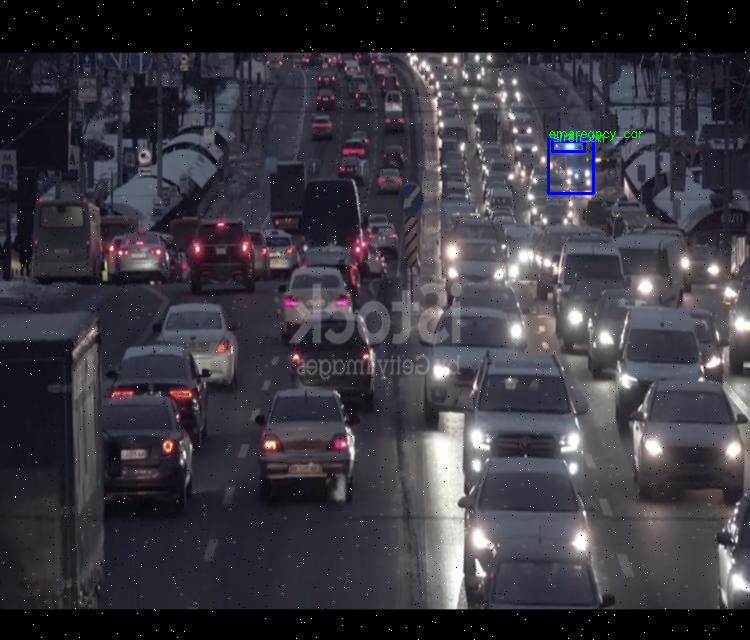

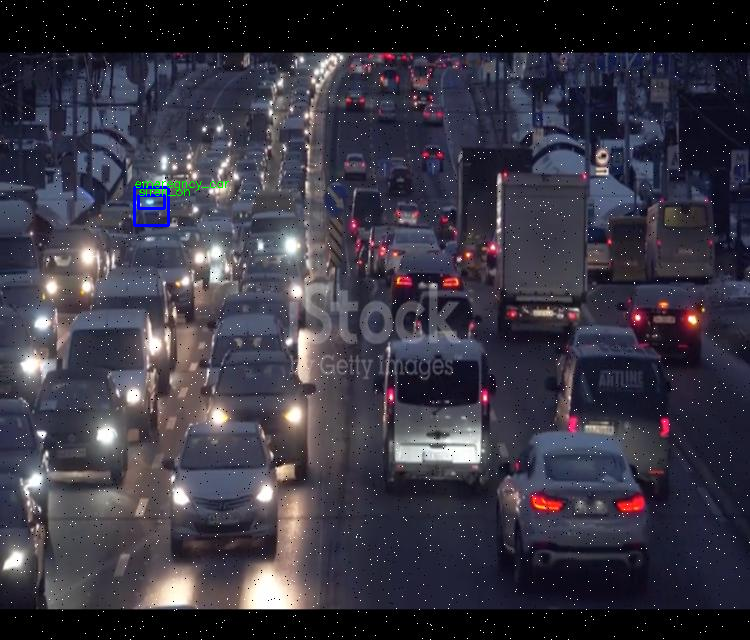

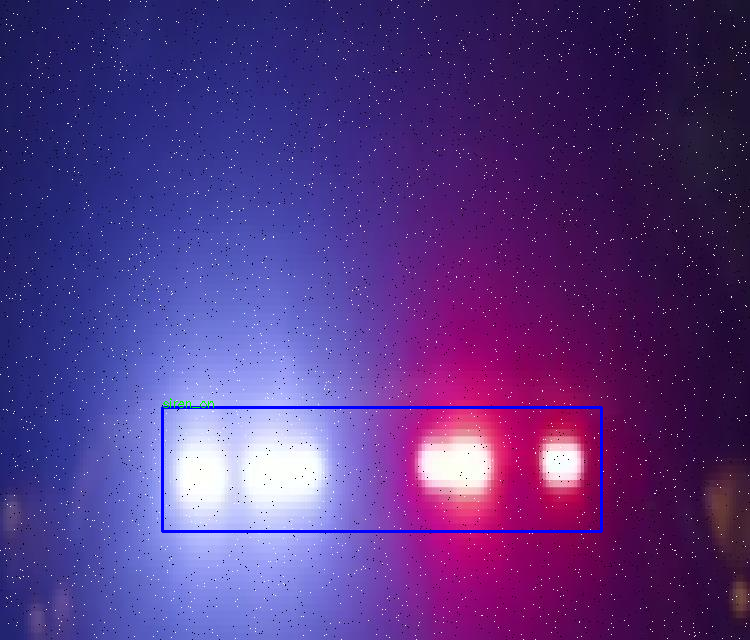

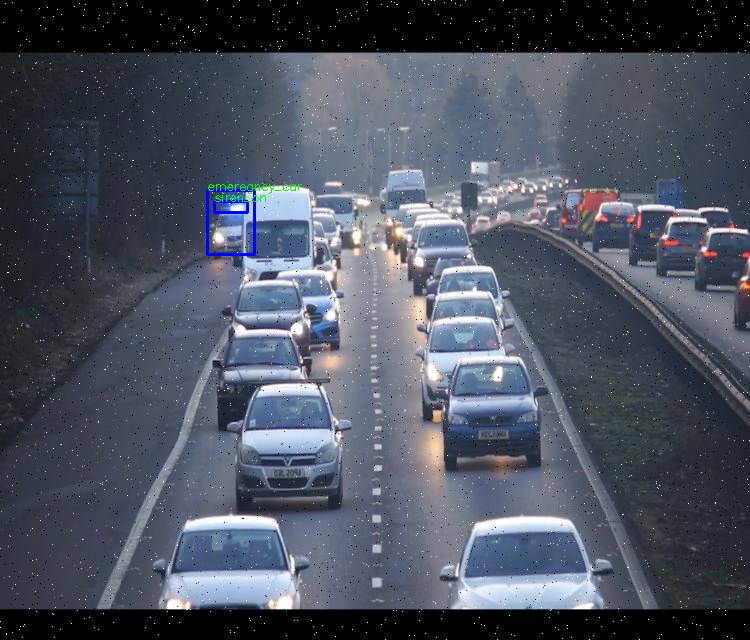

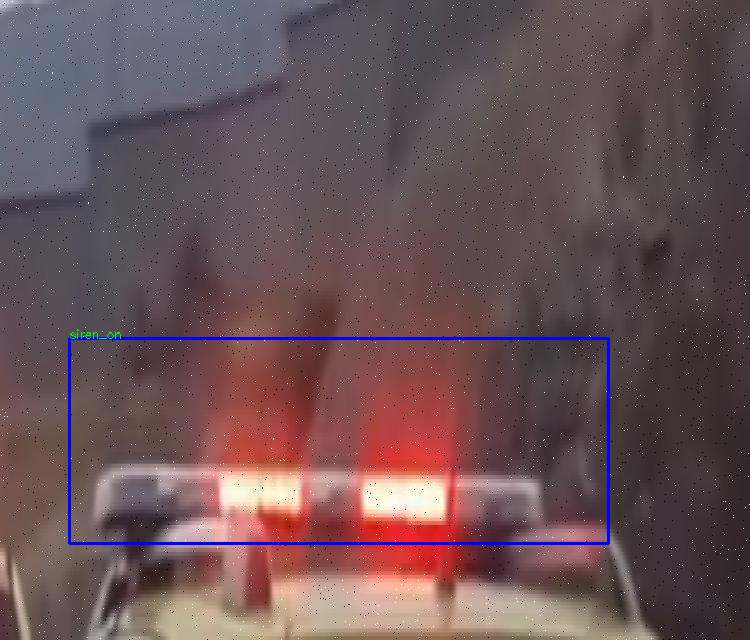

...

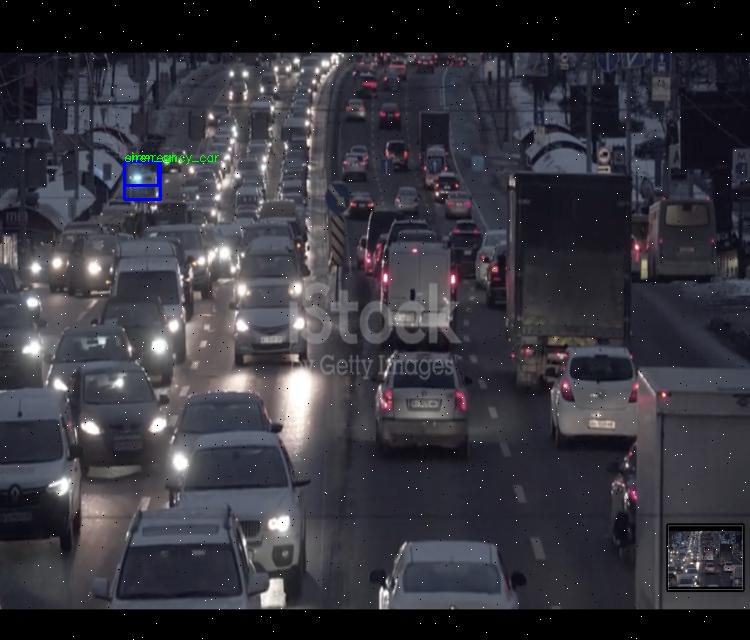

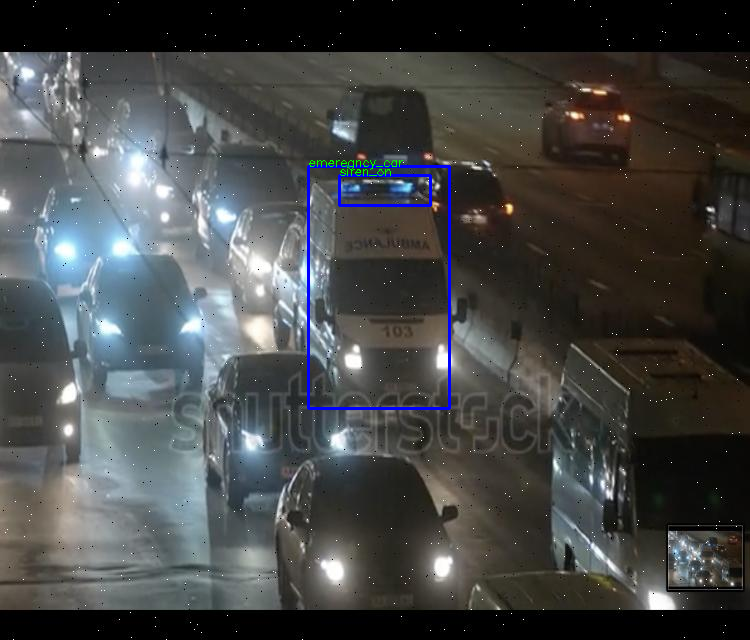

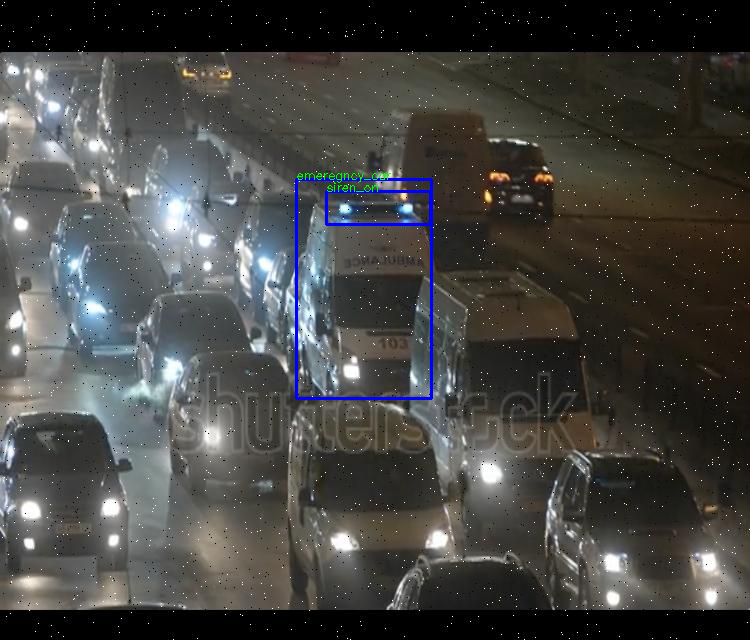

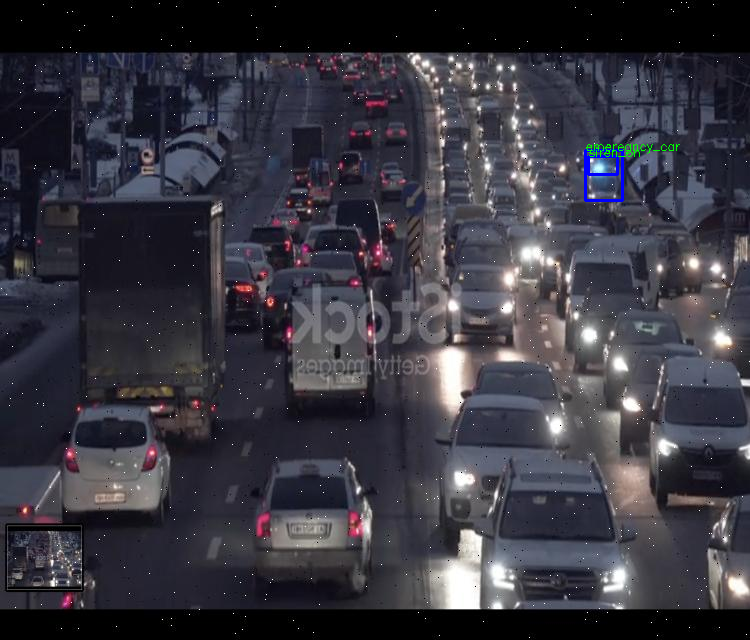

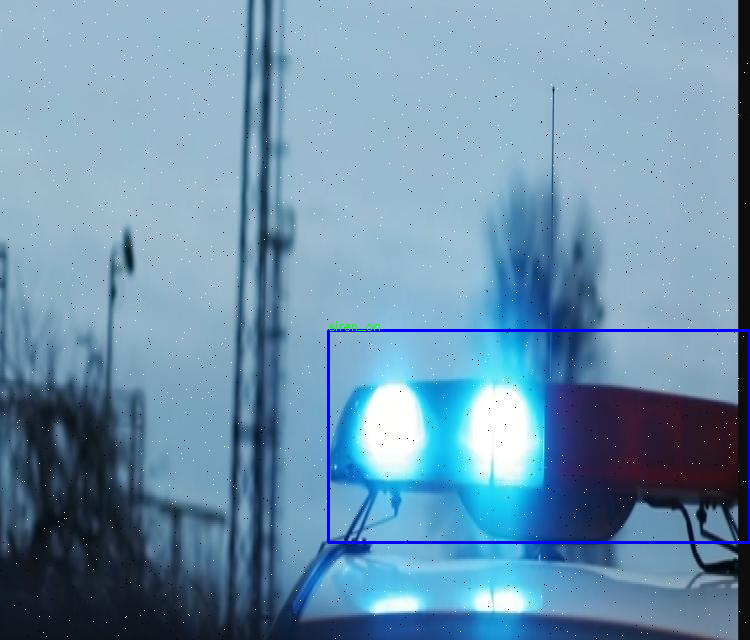

In [ ]:
import cv2
import numpy as np
import os
import random
from google.colab.patches import cv2_imshow  # For Google Colab, replace with cv2.imshow for local

# Function to read YOLO labels
def read_yolo_labels(label_file):
    with open(label_file, 'r') as f:
        lines = f.readlines()
    bboxes = []
    class_labels = []
    for line in lines:
        class_id, x, y, w, h = map(float, line.strip().split())
        bboxes.append([x, y, w, h])
        class_labels.append(int(class_id))
    return bboxes, class_labels

# Function to plot images with bounding boxes
def plot_image_with_bboxes(image, bboxes, class_labels, class_names):
    for bbox, label in zip(bboxes, class_labels):
        x, y, w, h = bbox
        start_point = (int((x - w / 2) * image.shape[1]), int((y - h / 2) * image.shape[0]))
        end_point = (int((x + w / 2) * image.shape[1]), int((y + h / 2) * image.shape[0]))
        image = cv2.rectangle(image, start_point, end_point, (255, 0, 0), 2)

        # Put the class name as a label instead of the index number
        class_name = class_names[label]
        cv2.putText(image, class_name, start_point, cv2.FONT_HERSHEY_SIMPLEX, 0.4, (0, 255, 0), 1)

    # Display the image with bounding boxes and class labels
    cv2_imshow(image)  # For Google Colab, replace with cv2.imshow for local machines

# Define the class names (example for your case)
class_names = ['siren_off', 'siren_off', 'emeregncy_car' ]

# Assuming you have a list of image paths and label paths
image_folder = '/content/sorted_emergency/train/images'  # Update to your image folder path
label_folder = '/content/sorted_emergency/train/labels'  # Update to your label folder path

# Get the image and label file paths
image_paths = [os.path.join(image_folder, img) for img in os.listdir(image_folder) if img.endswith('.jpg')]
label_paths = [os.path.join(label_folder, lbl.replace('.jpg', '.txt')) for lbl in os.listdir(image_folder) if lbl.endswith('.jpg')]

# Display 5 random images with bounding boxes
for i in range(30):
    idx = random.randint(0, len(image_paths) - 1)
    img = cv2.imread(image_paths[idx])

    # Read corresponding labels
    bboxes, class_labels = read_yolo_labels(label_paths[idx])

    # Plot the image with bounding boxes and class names
    plot_image_with_bboxes(img, bboxes, class_labels, class_names)
